### ECE/CS/ISyE 524 &mdash; Introduction to Optimization &mdash; Fall 2024 ###

# Path Smoothing #

#### Chaoyu Zhang (czhang759@wsic.edu), Student 2 (email address), Student 3 (email address), and Student 4 (email address)

*****

### Table of Contents

1. [Introduction](#1.-Introduction)
1. [Mathematical Model](#2.-Mathematical-model)
1. [Solution](#3.-Solution)
1. [Results and Discussion](#4.-Results-and-discussion)
  1. [Optional Subsection](#4.A.-Feel-free-to-add-subsections)
1. [Conclusion](#5.-Conclusion)

## 1. Introduction ##

Pathfinding is a critical concept in robotics, game development, and autonomous navigation. This project first uses the A* algorithm to find the shortest path on a map and then applies QP (Quadratic Programming) to smooth the route. In game maps, a smooth path can make character movement more natural and visually appealing. For example, in the game Baldur’s Gate, players click on a destination, and the character autonomously chooses the optimal path to reach the clicked location. Sharp turns can make character movement appear rigid. This project will use maps from Baldur’s Gate II for experimentation.

<div style="text-align: center;">
    <img src="./AR0011SR.png" alt="MAP1" title="MAP1" width="300"/>
    <p><em>Baldur's Gate II Map 1</em></p>
</div>

## 2. Mathematical Model

### Optimization Goal
Our goal is to optimize each point along a path such that the path becomes:
1. **As smooth as possible**: Reduce sharp turns to minimize curvature along the path.
2. **Close to the original path**: Keep the optimized path close to the initial path, ensuring that it maintains the general shape.

#### Smoothness Loss
The smoothness loss is designed to minimize the curvature of the path by using the second-order difference of the path points. This second-order difference approximates the second derivative of the path function, which reflects the path’s curvature.

For a continuous function $f(x)$, its second derivative at a point $x$, denoted $f''(x)$, can be approximated using Taylor expansion. Suppose we have three discrete points $x_{i-1}$, $x_i$, $x_{i+1}$, each separated by a distance $h$. We perform Taylor expansions for $f(x_{i+1})$ and $f(x_{i-1})$:

**Taylor Expansion of $f(x_{i+1})$**

$$
f(x_{i+1}) = f(x_i) + h f'(x_i) + \frac{h^2}{2} f''(x_i) + \frac{h^3}{6} f'''(x_i) + \cdots
$$

**Taylor Expansion of $f(x_{i-1})$**

$$
f(x_{i-1}) = f(x_i) - h f'(x_i) + \frac{h^2}{2} f''(x_i) - \frac{h^3}{6} f'''(x_i) + \cdots
$$

Adding these two expansions cancels the first derivative term $f'(x_i)$:

$$
f(x_{i+1}) + f(x_{i-1}) = 2f(x_i) + h^2 f''(x_i) + \text{higher order terms}
$$

Rearranging terms, we approximate $f''(x_i)$:

$$
f''(x_i) \approx \frac{f(x_{i+1}) - 2f(x_i) + f(x_{i-1})}{h^2}
$$

Thus, when $h = 1$,the second derivative can be approximated by the discrete points $x_{i-1}$, $x_i$, $x_{i+1}$:

$$
f(x_{i+1}) - 2f(x_i) + f(x_{i-1})
$$

In the path smoothing problem, we aim to minimize the curvature at each path point. Thus, we define the smoothness loss as the sum of squared second-order differences:

$$
\text{smoothness\_loss} = \sum_{i=2}^{N-1} \left((x[i-1] - 2x[i] + x[i+1])^2 + (y[i-1] - 2y[i] + y[i+1])^2\right)
$$

#### Proximity Loss
The proximity loss ensures that the optimized path remains close to the original path. Let the coordinates of the original path be $(x_0[i], y_0[i])$, and the optimized path points be $(x[i], y[i])$. The proximity loss is defined as the sum of squared Euclidean distances between each optimized point and its corresponding original point:

$$
\text{proximity\_loss} = \sum_{i=1}^N \left((x[i] - x_0[i])^2 + (y[i] - y_0[i])^2\right)
$$

#### constraints
To ensure that the path begins and ends at the specified locations, we introduce fixed constraints for the start and end points. These constraints anchor the optimized path to the original path's starting and ending points, ensuring that any adjustments made through optimization do not alter the intended entry and exit positions. 

For a given path with coordinates $(x_0[1], y_0[1])$ as the start point and $(x_0[N], y_0[N])$ as the end point, the fixed start and end constraints are defined as follows:

$$
x[1] = x_0[1], \quad y[1] = y_0[1]
$$

$$
x[N] = x_0[N], \quad y[N] = y_0[N]
$$

Obstacle Avoidance (if applicable): Additional constraints can be included to ensure that path points are within feasible (obstacle-free) regions.


### Model Summary


#### Objective Function
We aim to minimize the weighted total loss:

$$
\min \quad \alpha \times \text{smoothness\_loss} + \beta \times \text{proximity\_loss}
$$

where:
- $\alpha$ is the weight for the smoothness loss, encouraging the path to avoid sharp turns.
- $\beta$ is the weight for the proximity loss, encouraging the path to stay close to the original path.


#### Decision Variables
The decision variable $x$ represents the optimized $x$- and $y$-coordinates of each path point.

$$
x = [x[1], y[1], x[2], y[2], \ldots, x[N], y[N]]
$$

#### Constraints
$$
x[1] = x_0[1], \quad y[1] = y_0[1]
$$

$$
x[N] = x_0[N], \quad y[N] = y_0[N]
$$


### Conversion to Standard QCQP Form
To simplify solving this optimization problem, we convert it to a standard Quadratically Constrained Quadratic Programming (QCQP) form:

$$
\min_x \quad \frac{1}{2} x^T P_0 x + q_0^T x + r_0
$$


#### more detailed will be added soon

## 3. Implementation ##

Here, you should code up your model in Julia + JuMP and solve it. Your code should be clean, easy to read, well annotated and commented, and it should compile! You are not allowed to use other programming languages or DCP packages such as `convex.jl`. **We will be running your code, and you want to make sure that everything works if we run the code blocks in sequence**. Having multiple code blocks separated by text blocks (either as separate cells or blocks of comments) that explain the various parts of your solution will make it much easier for us to understand your project. 

We would also like to see that you make several variants or run different kinds of analysis for your problem (e.g. by changing the input parameters, the constraints or objective, or deriving a dual problem). We expect at least one-two such problem variants as part of your project.

**Remember that if you do not write your description of the project and commeent your code well, we cannot understand what you have done. Even if it is technically brilliant, you will loose points if you do not write well and comment your code well.**
It's fine to call solvers and external packages we have used in the course such as `Gurobi` or `Plots`, but try to minimize the use of other packages. We want to be able to understand what is happening in your code without looking up additional references. 

This is Ipopt version 3.14.16, running with linear solver MUMPS 5.7.3.

Number of nonzeros in equality constraint Jacobian...:        4
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:       36

Total number of variables............................:       14
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        4
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.7000000e+01 6.00e+00 1.00e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00 

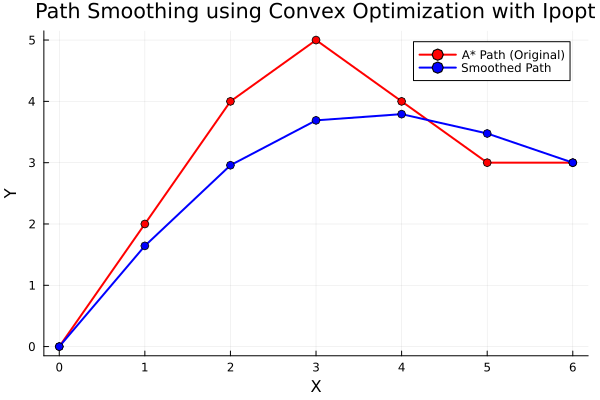

In [3]:
using LinearAlgebra
using Ipopt
using JuMP
using Plots
using Random

function generate_astar_path()
    return [0.0 0.0; 1.0 2.0; 2.0 4.0; 3.0 5.0; 4.0 4.0; 5.0 3.0; 6.0 3.0]
end

function smooth_path(path, alpha=0.5, beta=0.1)
    
    N = size(path, 1)
    x0, y0 = path[:, 1], path[:, 2]

    model = Model(Ipopt.Optimizer)

    @variable(model, x[1:N])
    @variable(model, y[1:N])

    @constraint(model, x[1] == x0[1])
    @constraint(model, y[1] == y0[1])
    @constraint(model, x[N] == x0[N])
    @constraint(model, y[N] == y0[N])

    smoothness_loss = sum((x[i-1] - 2 * x[i] + x[i+1])^2 + (y[i-1] - 2 * y[i] + y[i+1])^2 for i in 2:N-1)
    proximity_loss = sum((x[i] - x0[i])^2 + (y[i] - y0[i])^2 for i in 1:N)
    
    @objective(model, Min, alpha * smoothness_loss + beta * proximity_loss)

    optimize!(model)
    
    optimized_x = value.(x)
    optimized_y = value.(y)
    
    return hcat(optimized_x, optimized_y)
end

path = generate_astar_path()
smoothed_path = smooth_path(path)

plot(path[:, 1], path[:, 2], label="A* Path (Original)", lw=2, marker=:o, color=:red)
plot!(smoothed_path[:, 1], smoothed_path[:, 2], label="Smoothed Path", lw=2, marker=:o, color=:blue)
xlabel!("X")
ylabel!("Y")
title!("Path Smoothing using Convex Optimization with Ipopt")

This is Ipopt version 3.14.16, running with linear solver MUMPS 5.7.3.

Number of nonzeros in equality constraint Jacobian...:        4
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:       24

Total number of variables............................:       10
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        4
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  6.0000000e+00 5.00e+00 8.00e-01  -1.0 0.00e+00    -  0.00e+00 0.00e+00 

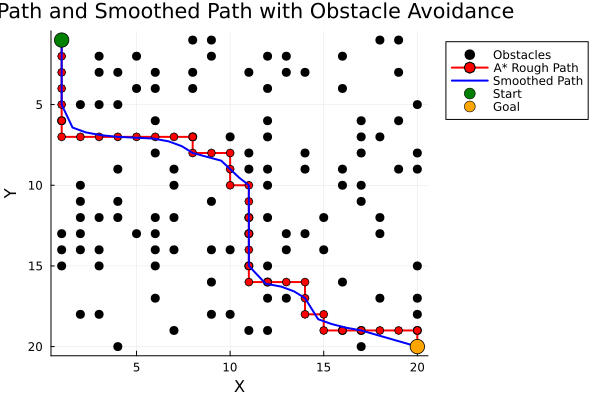

In [6]:
using Random
using LinearAlgebra
using JuMP
using Ipopt
using Plots

function generate_environment(grid_size, obstacle_ratio=0.3)
    env = rand(grid_size, grid_size) .< obstacle_ratio
    return env
end

function print_environment(env, start, goal)
    grid_size = size(env, 1)
    println("Environment:")
    for i in 1:grid_size
        for j in 1:grid_size
            if env[i, j]
                print(" X ")  
            elseif (i, j) == start
                print(" S ")  
            elseif (i, j) == goal
                print(" G ")  
            else
                print(" . ")  
            end
        end
        println()
    end
end

using DataStructures

function manhattan_distance(a, b)
    return abs(a[1] - b[1]) + abs(a[2] - b[2])
end

function astar(env, start, goal)
    grid_size = size(env, 1)
    open_set = PriorityQueue{Tuple{Int,Int}, Float64}()
    open_set[start] = 0.0
    came_from = Dict{Tuple{Int,Int}, Tuple{Int,Int}}()
    g_score = Dict{Tuple{Int,Int}, Float64}(start => 0.0)
    f_score = Dict{Tuple{Int,Int}, Float64}(start => manhattan_distance(start, goal))

    neighbors = [(1, 0), (-1, 0), (0, 1), (0, -1)]

    while !isempty(open_set)
        current = dequeue!(open_set)
        
        if current == goal
            path = []
            while haskey(came_from, current)
                push!(path, current)
                current = came_from[current]
            end
            push!(path, start)
            return reverse(path)
        end

        for (dx, dy) in neighbors
            neighbor = (current[1] + dx, current[2] + dy)
            
            if 1 <= neighbor[1] <= grid_size && 1 <= neighbor[2] <= grid_size && !env[neighbor...]
                tentative_g_score = g_score[current] + 1
                if tentative_g_score < get(g_score, neighbor, Inf)
                    came_from[neighbor] = current
                    g_score[neighbor] = tentative_g_score
                    f_score[neighbor] = tentative_g_score + manhattan_distance(neighbor, goal)
                    open_set[neighbor] = f_score[neighbor]
                end
            end
        end
    end
    return []  # No path found
end


function smooth_segment(path_segment, alpha=0.5, beta=0.1)
    N = size(path_segment, 1)
    x0, y0 = path_segment[:, 1], path_segment[:, 2]

    model = Model(Ipopt.Optimizer)

    @variable(model, x[1:N])
    @variable(model, y[1:N])

    @constraint(model, x[1] == x0[1])
    @constraint(model, y[1] == y0[1])
    @constraint(model, x[N] == x0[N])
    @constraint(model, y[N] == y0[N])
    
    # Smoothness loss： use the second derivative of the path to penalize sharp turns
    smoothness_loss = sum((x[i-1] - 2 * x[i] + x[i+1])^2 + (y[i-1] - 2 * y[i] + y[i+1])^2 for i in 2:N-1)
    # Proximity loss: penalize the deviation of the smoothed path from the original path
    proximity_loss = sum((x[i] - x0[i])^2 + (y[i] - y0[i])^2 for i in 1:N)
    
    @objective(model, Min, alpha * smoothness_loss + beta * proximity_loss)

    optimize!(model)
    
    optimized_x = value.(x)
    optimized_y = value.(y)
    
    return hcat(optimized_x, optimized_y)
end

function smooth_path_with_segments(rough_path, segment_size=5)
    smoothed_path = Matrix{Float64}(undef, 0, 2)  

    for i in 1:segment_size:size(rough_path, 1) - segment_size + 1
        segment = rough_path[i:i+segment_size-1, :]
        smoothed_segment = smooth_segment(segment)
        
        if i == 1
            smoothed_path = vcat(smoothed_path, smoothed_segment)
        else
            smoothed_path = vcat(smoothed_path, smoothed_segment[2:end, :]) 
        end
    end
    
    if smoothed_path[end, :] != rough_path[end, :]
        smoothed_path = vcat(smoothed_path, reshape(rough_path[end, :], 1, 2))
    end

    return smoothed_path
end

grid_size = 20
obstacle_ratio = 0.3
env = generate_environment(grid_size, obstacle_ratio)
start = (1, 1)
goal = (grid_size, grid_size)

# print_environment(env, start, goal)

rough_path_coords = astar(env, start, goal)
if isempty(rough_path_coords)
    println("No path found!")
else

    rough_path = hcat([x[1] for x in rough_path_coords], [x[2] for x in rough_path_coords])
    smoothed_path = smooth_path_with_segments(rough_path)

    
    obs_coords = collect(Tuple.(findall(env .== 1)))
    obs_x = [coord[2] for coord in obs_coords]  
    obs_y = [coord[1] for coord in obs_coords]  

  
    scatter(obs_x, obs_y, color=:black, label="Obstacles", markersize=5, yflip=true)

    
    plot!(rough_path[:, 1], rough_path[:, 2], label="A* Rough Path", color=:red, lw=2, marker=:o)
    plot!(smoothed_path[:, 1], smoothed_path[:, 2], label="Smoothed Path", color=:blue, lw=2)

   
    scatter!([start[2]], [start[1]], label="Start", color=:green, markersize=8) 
    scatter!([goal[2]], [goal[1]], label="Goal", color=:orange, markersize=8)  

    
    xlabel!("X")
    ylabel!("Y")
    title!("A* Path and Smoothed Path with Obstacle Avoidance")
    plot!(legend=:outertopright)  
end


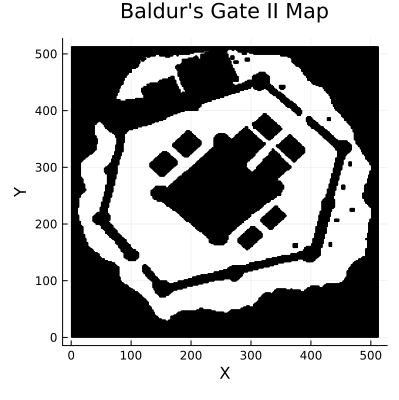

In [ ]:
# create environment from map file

function load_map_to_matrix(filename)
    open(filename, "r") do f
        for _ in 1:4  
            readline(f)
        end

        map_matrix = []
        for line in eachline(f)
            row = [ch == '.' ? 0 : 1 for ch in line]  
            push!(map_matrix, row)
        end
        return hcat(map_matrix...)'  
    end
end

function plot_environment(env)
    obs_coords = collect(Tuple.(findall(env .== 1)))
    obs_x = [coord[2] for coord in obs_coords]
    obs_y = [coord[1] for coord in obs_coords]
    
    scatter(obs_x, obs_y, color=:black, label="Obstacles", markersize=1, 
            size=(400, 400), legend=false)

    xlabel!("X")
    ylabel!("Y")
    title!("Baldur's Gate II Map")
end

filename = "./AR0011SR.map"  
env = load_map_to_matrix(filename)

plot_environment(env)

Remember to make sure your code compiles! We will be running your code!

## 4. Results and discussion ##

In this section, you display and discuss the results. Show figures, plots, images, trade-off curves, or whatever else you can think of to best illustrate your results. The discussion should explain what the results mean, and how to interpret them. You should also explain the limitations of your approach/model and how sensitive your results are to the assumptions you made.

Use plots (see `PyPlot` examples from class), or you can display results in a table like this:

| Tables        | Are           | Cool  |
| ------------- |:-------------:| -----:|
| col 3 is      | right-aligned |\$1600 |
| col 2 is      | centered      |  \$12 |
| zebra stripes | are neat      |   \$1 |


### You can add change the format of sections 2, 3 and 4 to accomodate multiple versions of your model, sensitivity analysis etc. Just make sure that you answer all the questions we have stated in the final version of your report.

### 4.A. You can also add subsections

#### 4.A.a. or subsubsections
Having more structure in the report can help readers understand your analysis and results!

## 5. Conclusion ##

Summarize your findings and your results, and talk about at least one possible future direction; something that might be interesting to pursue as a follow-up to your project.

## 6. Author Contributions

Note: The contributions in each category must sum to 100%. See Canvas for more details on what type of work belongs in each category.

#### 1. Modelling  
Student A: Percentage contribution %  
Student B: Percentage contribution %  
Student C: Percentage contribution %  

  
#### 2. Analysis  
Student A: Percentage contribution %  
Student B: Percentage contribution %  
Student C: Percentage contribution %  


#### 3. Data Gathering  
Student A: Percentage contribution %  
Student B: Percentage contribution %  
Student C: Percentage contribution %  


#### 4. Software Implementation  
Student A: Percentage contribution %  
Student B: Percentage contribution %  
Student C: Percentage contribution %  


#### 5. Report Writing    
Student A: Percentage contribution %  
Student B: Percentage contribution %  
Student C: Percentage contribution %  